In [19]:
# Goal is to compare the performance of the summer models vs the fall models
# There seems to be an issue when comparing the distribution of multicrystal
# The current hypothesis is that this is going to be edvident by looking at 

from facet_ml.classification.model_using import *
from facet_ml.segmentation.segmenter import ImageSegmenter
from facet_ml.classification.model_training import load_feature_config
import os
import pickle
import numpy as np
import cv2
import copy
import glob
import tqdm
from pathlib import Path

In [20]:
## Load Models for Summer and Fall
__file__ = "/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Workbooks/Summer-2023_vs_Fall-2023.ipynb"

model_folder = Path(__file__).parent.parent / "facet_ml" / "static" / "Models"

# Fall
fall_features =  load_feature_config("default_features-agnostic")
fall_set = "2023_original_default_features-agnostic"
fall_folder = model_folder / fall_set
fall_CvMC_path = os.path.join(fall_folder,"RF_C_MC.sav")
fall_CvI_path = os.path.join(fall_folder,"RF_C-MC_I.sav")
with open(fall_CvMC_path,"rb") as f:
    fall_CvMC = pickle.load(f)
with open(fall_CvI_path,"rb") as f:
    fall_CvI = pickle.load(f)

# Summer
summer_features =  load_feature_config("default_features")
summer_set = "model_set__original_2023_classifier"
summer_folder = model_folder / summer_set
summer_CvNC_path = summer_folder / "C-MC_I-P.sav"
summer_IvP_path = summer_folder / "I_P.sav"
summer_CvMC_path = summer_folder / "C_MC.sav"

with open(summer_CvMC_path,"rb") as f:
    summer_CvMC = pickle.load(f)["model"]
with open(summer_CvNC_path,"rb") as f:
    summer_CvNC = pickle.load(f)["model"]
with open(summer_IvP_path,"rb") as f:
    summer_IvP = pickle.load(f)["model"]

/Users/jacobpietryga/anaconda3/envs/colloidal_crystal_env/lib/python3.10/site-packages/sklearn/base.py:288: UserWarning: Trying to unpickle estimator DecisionTreeClassifier from version 1.0.2 when using version 1.2.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/Users/jacobpietryga/anaconda3/envs/colloidal_crystal_env/lib/python3.10/site-packages/sklearn/base.py:288: UserWarning: Trying to unpickle estimator RandomForestClassifier from version 1.0.2 when using version 1.2.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [21]:
## Build Model Applications for each

# Baseline Image Segmenter
threshold_mode = "ensemble"
IS = ImageSegmenter(input_path=None,
               threshold_mode=threshold_mode,
               edge_modification="localthresh",)

# Fall
fall_MA_CvMC = ModelApplication(fall_CvMC,IS,features=fall_features)
fall_MA_CvI = ModelApplication(fall_CvI,IS,features=fall_features,
                               replacement_dict={
                                          "Crystalline":fall_MA_CvMC,
                                          "Not Crystalline":"Incomplete"
                                      }
                               )

# Summer
summer_MA_CvMC = ModelApplication(summer_CvMC,IS,features=summer_features)
summer_MA_IvP = ModelApplication(summer_IvP,IS,features=summer_features)
summer_MA_CvNC = ModelApplication(summer_CvNC,IS,features=summer_features,
                                  replacement_dict={
                                          "Crystalline":summer_MA_CvMC,
                                          "Not Crystalline":summer_MA_IvP
                                      }
                                  )

(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Multiple Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Multiple Crystal
Multiple Cryst

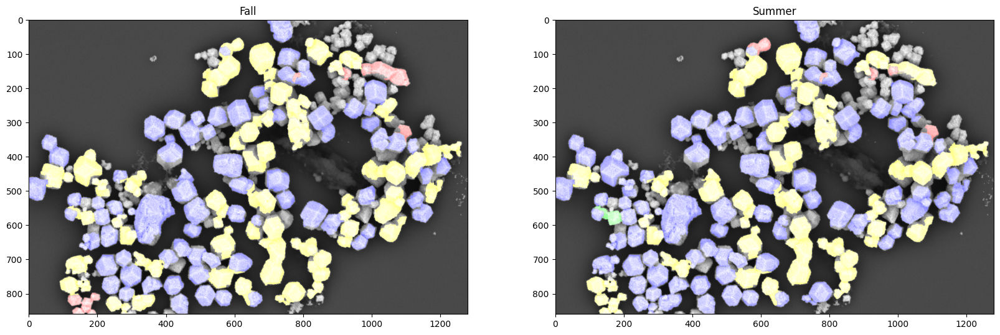

In [22]:
## Check the structure works
# Compare model output on input_image

def run_two_models(MA_1:ModelApplication,MA_2:ModelApplication,img_path,save_folder,
                   tag_1="MA_1",
                   tag_2="MA_2"):
    
    # Make sure the save folder exists
    os.makedirs(save_folder,exist_ok=True)
    
    img_path = Path(img_path)
    img_id = img_path.stem

    # Load img
    MA_1.image = str(img_path)
    MA_2.image = str(img_path)

    # Get MA_1 info
    IS_1 = MA_1.image_segmenter
    IS_1.df["Labels"] = MA_1.run()
    MA_1_color_img = visualize_labels(IS_1,IS_1.df)
    df_1_save_path = os.path.join(
        save_folder,
        f"{img_id}_{tag_1}.csv"
    )
    IS_1.df.to_csv(df_1_save_path)

    # Get MA_1 info
    IS_2 = MA_2.image_segmenter
    IS_2.df["Labels"] = MA_2.run()
    MA_2_color_img = visualize_labels(IS_2,IS_2.df)
    df_2_save_path = os.path.join(
        save_folder,
        f"{img_id}_{tag_2}.csv"
    )
    IS_2.df.to_csv(df_2_save_path)

    import matplotlib.pyplot as plt 

    fig,ax = plt.subplots(ncols=2,figsize=(20,10))
    ax[0].imshow(MA_1_color_img)
    ax[0].set_title(tag_1)
    ax[1].imshow(MA_2_color_img)
    ax[1].set_title(tag_2)

    fig_save_path = os.path.join(
        save_folder,
        f"{img_id}_{tag_1}-{tag_2}_compare.png"
    )
    fig.savefig(fig_save_path)

# Test function
img_path = "/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/Training/39.5 hold 8.bmp"

run_two_models(fall_MA_CvI,summer_MA_CvNC,img_path,"Test_Fall-Summer","Fall","Summer")

  0%|          | 0/8 [00:00<?, ?it/s]

(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Incomplete
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crysta

 12%|█▎        | 1/8 [00:15<01:50, 15.77s/it]

(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal

 25%|██▌       | 2/8 [00:38<01:58, 19.70s/it]

(860, 1280)
(860, 1280)
(860, 1280)


/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Multiple Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Multiple Crystal
Multiple Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Multiple Crystal
Multiple Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Multiple Crys

/var/folders/vk/znvr66h543g3tt_w4mwmsslh0000gn/T/ipykernel_15424/3004871861.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(ncols=2,figsize=(20,10))


(860, 1280)
(860, 1280)
(860, 1280)
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Crystal
Multiple Crystal
Incomplete
Incomplete
Multiple Crystal
Multiple Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Poorly Segmented
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Cryst

 38%|███▊      | 3/8 [01:08<02:03, 24.70s/it]

(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Multiple Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Multiple Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomp

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: divide by zero encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
(860, 1280)
(860, 1280)
(860, 1280)
Multiple Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
(8

 50%|█████     | 4/8 [01:30<01:33, 23.32s/it]

Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_07.txt
Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_06.txt
Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_04.txt
Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_10.txt
(860, 1280)
(860, 1280)
(860, 1280)
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal

 62%|██████▎   | 5/8 [01:57<01:14, 24.89s/it]

Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_08.txt
Illegal File type: /Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates/L-3_nM-10_mixing-F_rate_per50min/L-3_mixing-F_oven-F_rate_per50min_09.txt
(860, 1280)
(860, 1280)
(860, 1280)
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
(860, 1280)
(860, 1280)
(860, 1280)


/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: divide by zero encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Poorly Segmented
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Cr

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: invalid value encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:540: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/major_axis_length'] = clusters['perimeter']/clusters['major_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Crystal
Crystal
Multiple Crystal
Multiple Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Multiple Crystal
Multiple Crystal
Crystal
Incomplete
Multiple Crystal
Multiple Crystal
Multiple Crystal
Incomplete
Multiple Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Incomplete
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: invalid value encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:540: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/major_axis_length'] = clusters['perimeter']/clusters['major_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Multiple Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Multiple Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Multiple Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crys

 75%|███████▌  | 6/8 [02:22<00:49, 24.94s/it]

(860, 1280)
(860, 1280)
(860, 1280)
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incompl

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: invalid value encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:540: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/major_axis_length'] = clusters['perimeter']/clusters['major_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incom

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete


/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Crystal
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Inc

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: divide by zero encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: invalid value encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Incomplete
Crystal
Inc

 88%|████████▊ | 7/8 [03:16<00:34, 34.26s/it]

(860, 1280)
(860, 1280)
(860, 1280)


/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: divide by zero encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Multiple Crystal
Incomplete
Crystal
Incomplete
Multiple Crystal
Multiple Crystal
Multiple Crystal
Incomplete
Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Multiple Crystal
Crystal
Crystal
Poorly Segmented
Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Poorly Segmented
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Crystal
Crystal
Multiple Crystal
Incomplete
Multiple Crystal
Multiple Cr

/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:539: RuntimeWarning: divide by zero encountered in divide
  clusters['major_axis_length/minor_axis_length'] = clusters['major_axis_length']/clusters['minor_axis_length']
/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/facet_ml/segmentation/segmenter.py:541: RuntimeWarning: divide by zero encountered in divide
  clusters['perimeter/minor_axis_length'] = clusters['perimeter']/clusters['minor_axis_length']


Crystal
Incomplete
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Incomplete
Incomplete
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Incomplete
Crystal
Multiple Crystal
Incomplete
Crystal
Incomplete
Incomplete
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Crystal
Multiple Crystal
Crystal
Crystal
Incomplete
Crystal
Multiple Crystal
Incomplete
Incomplete
Incomplete
Multiple Crystal
Incomplete
Crystal
Incomplete
Crystal
Incomplete
Multiple Crystal
Crystal
Incomplete
Incomplete
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Multiple Crystal
Crystal
Crystal
Multiple Crystal
Incomplete
Incomplete
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Crystal
Multiple Crystal
Crystal
Incomplete
Poorly Segmented
Crystal
Multiple Crystal
Multiple Crystal

100%|██████████| 8/8 [03:52<00:00, 29.07s/it]


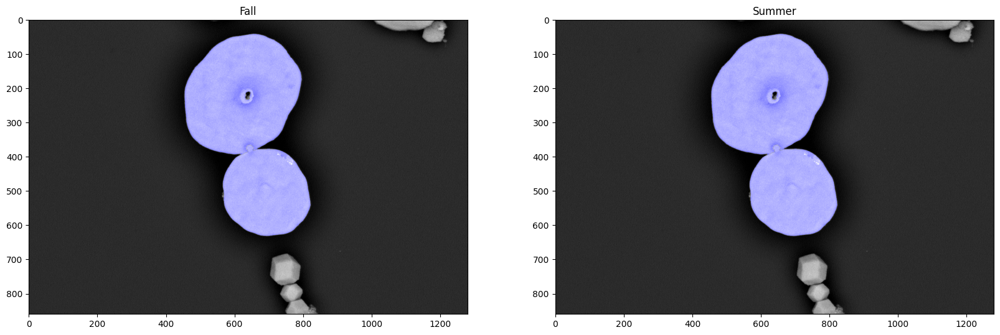

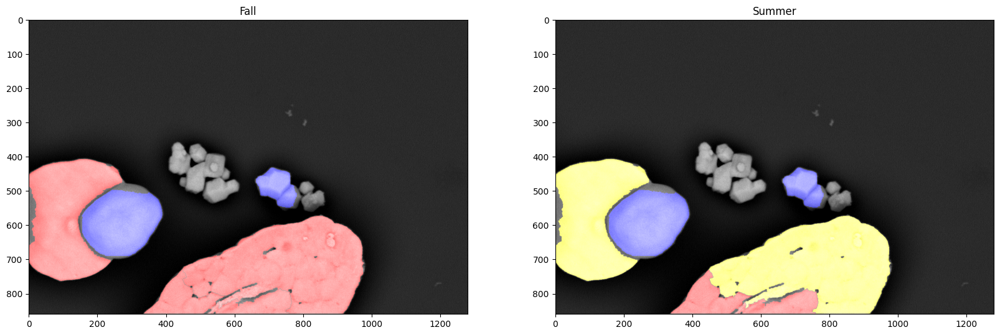

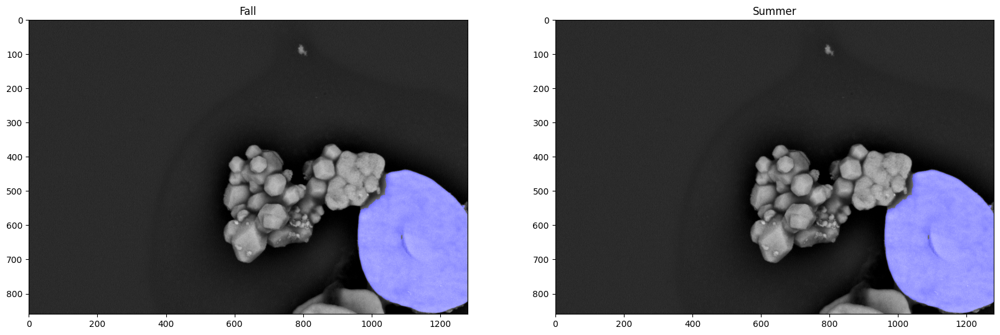

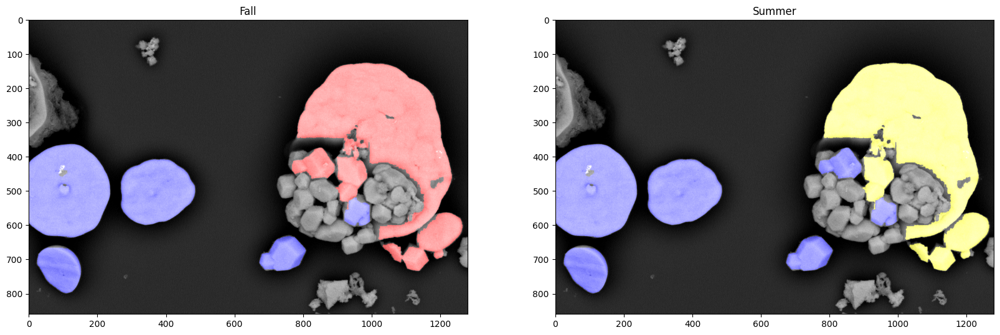

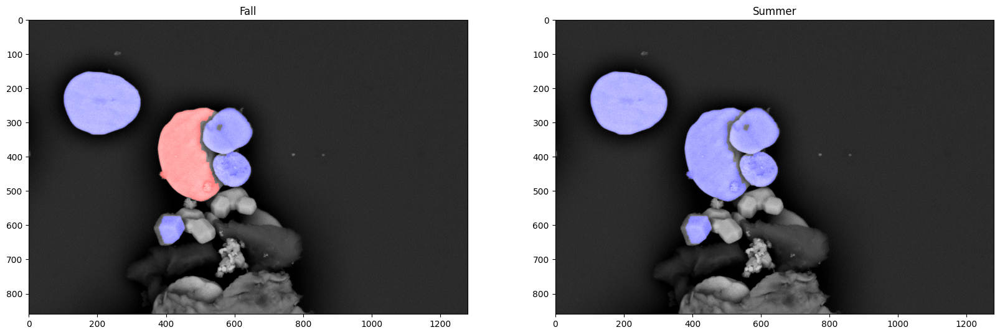

...

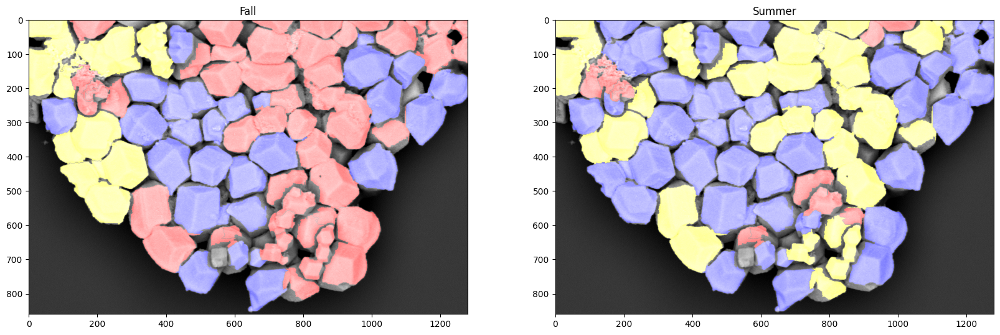

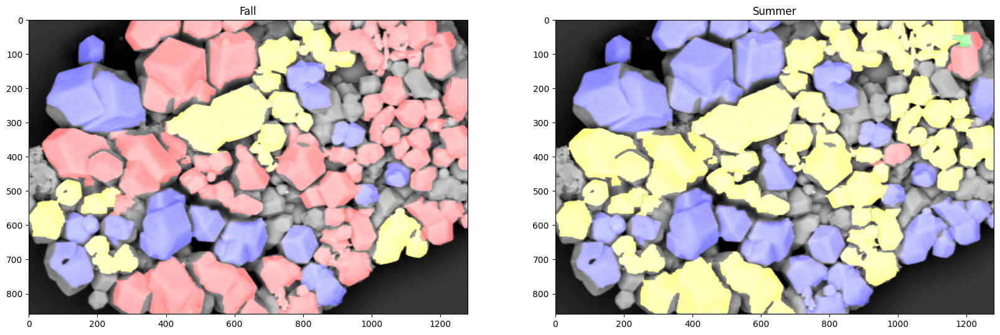

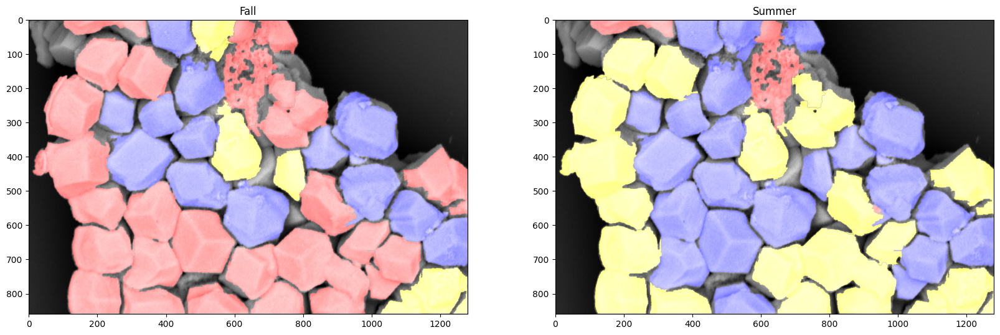

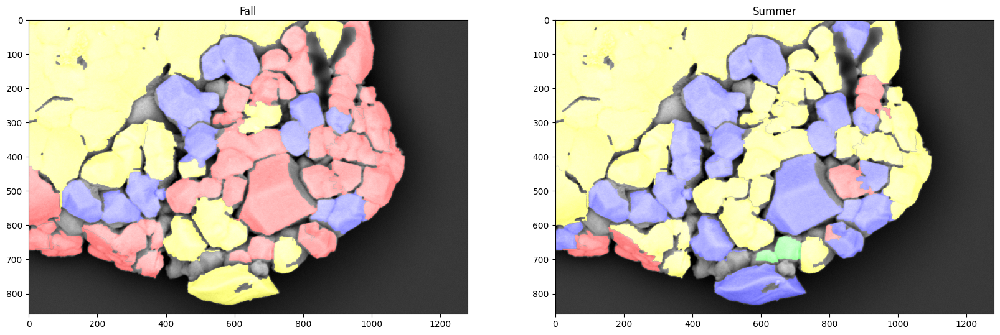

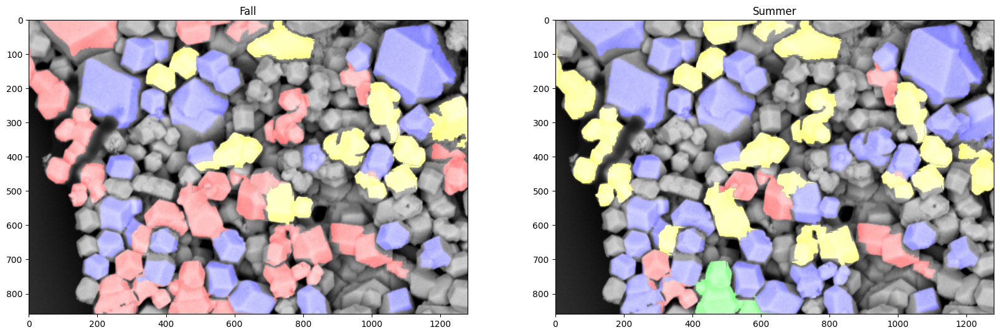

In [23]:
## Set up grandscale comparison
problem_file = "L-3_nM-10_mixing-F_rate_per50min"
completed_folders = [

]

import tqdm
parent_folder = "/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/2023_11_Organized_Images"
parent_folder = "/Users/jacobpietryga/Desktop/Academics/colloidal_crystal_ML/Images/slow_cooling_rates"
sub_folders = glob.glob( os.path.join(parent_folder,"*") )

for sub_folder in tqdm.tqdm(sub_folders):
    img_paths = glob.glob( os.path.join(sub_folder,"*") )

    sub_folder_id = Path(sub_folder).stem
    if sub_folder_id in completed_folders:
        continue
    save_folder = os.path.join(f"{threshold_mode}_slow_cooling_rate",sub_folder_id)

    for img_path in img_paths:
        try:
            run_two_models(fall_MA_CvI,summer_MA_CvNC,img_path,save_folder,"Fall","Summer")
        except:
            print(f"Illegal File type: {img_path}")

In [24]:
# Append csvs together
import sys
sys.path.append("..")
from Utility import process_data_utils as pdu

parent_folder = f"{threshold_mode}_slow_cooling_rate"

# Get list of fall csvs
csv_list = [p for p in glob.glob( os.path.join(parent_folder,"*","*") ) if "csv" in p]
fall_csvs = [p for p in csv_list if "Fall" in p]
summer_csvs = [p for p in csv_list if "Summer" in p]

fall_df = pdu.create_formatted_df(fall_csvs)
summer_df = pdu.create_formatted_df(summer_csvs)

In [25]:
fall_df.to_csv(f"Fall_Model_slow_Cooling_{threshold_mode}.csv")
summer_df.to_csv(f"Summer_Model_Slow_Cooling_{threshold_mode}.csv")



In [26]:
fall_df["Labels"].value_counts()

Incomplete          1535
Crystal             1353
Multiple Crystal     398
Name: Labels, dtype: int64

In [27]:
summer_df["Labels"].value_counts()

Crystal             2064
Multiple Crystal     650
Incomplete           530
Poorly Segmented      42
Name: Labels, dtype: int64